Mount drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Import essential libraries

In [ ]:
import pandas as pd
import requests
import cv2 as cv
from google.colab.patches import cv2_imshow # for image display
from skimage import io
from urllib.request import urlopen

Make dataframe

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/2019-vgkg-protest-image-dataset-20191030-labels.csv/2019-vgkg-protest-image-dataset-20191030-labels.csv")

In [ ]:
df.columns = ['TimeStamp', 'img_url', 'web_url']

In [ ]:
df

,TimeStamp,img_url,web_url
0,2.017081e+13,http://24.com.eg/temp/resized/medium_2017-08-1...,http://24.com.eg/arab-world/3032583.html
1,2.017082e+13,http://25088a80940e.bitsngocdn.net/wp-content/...,http://www.elciudadano.cl/politica/mesa-del-fr...
2,2.017012e+13,http://KOTV.images.worldnow.com/images/1291831...,http://m.newson6.com/Story.aspx?story=34265732...
3,2.016022e+13,http://a9.vietbao.vn/images/vn999/150/2016/02/...,http://vietbao.vn/Kinh-te/Canh-xep-hang-rong-r...
4,2.017021e+13,http://adevarul.ro/assets/adevarul.ro/MRImage/...,http://adevarul.ro/locale/bistrita/bistritenii...
...,...,...,...
5562609,2.017103e+13,https://www.welt.de/img/newsticker/dpa_nt/info...,https://www.welt.de/newsticker/dpa_nt/infoline...
5562610,2.019073e+13,https://www.wvxu.org/sites/wvxu/files/201907/O...,https://www.wvxu.org/post/residents-march-otr-...
5562611,2.017092e+13,https://www.ynet.co.il/PicServer5/2017/09/18/8...,"https://www.ynet.co.il/articles/0,7340,L-50182..."
5562612,2.018021e+13,https://www.ziuaconstanta.ro/images/stories/20...,http://www.ziuanews.ro/revista-presei/apel-dis...


Remove invalid URLs for a sample of the data

In [ ]:
i = 0
image_urls = []

while i <= 25:
  i = i + 1
  try:
    urlopen(df.iat[i,1])
  except:
    continue
  image_urls.append(df.iat[i,1])


In [ ]:
image_urls

['http://amp.dw.com/image/40084587_101.jpg',
 'http://baodongnai.com.vn/dataimages/201909/original/images2231215_H4.JPG',
 'http://binaryapi.ap.org/47bf0ba477b0405397f8cdf9fa5a8a93/460x.jpg',
 'http://bwabtk.com/temp/resized/medium_2016-08-24-bd43360f5c.jpg',
 'http://cadenaser00.epimg.net/emisora/imagenes/2016/10/24/ser_madrid_sur/1477304865_000801_1477305124_noticia_normal.jpg',
 'http://catholicsentinel.org/Images/Images/128908.jpg',
 'http://cde.peru21.pe/ima/0/0/4/0/4/404045.jpg',
 'http://cdn-2.tstatic.net/jogja/foto/bank/images/aksi-aliansi-mahasiswa-independen-peduli-hukum_20160915_154746.jpg',
 'http://cdn.diario26.com.ar/media/image/2018/04/25/387344.jpg?s=2',
 'http://cdn.expansion.mx/32/94/c6463cf447e6bfd179cbb05f4cbb/protestas-magisteriales.jpg',
 'http://cdn.hispantv.com/hispanmedia/files/images/thumbnail/20170718/01321953_xl.jpg',
 'http://cdn.images.express.co.uk/img/dynamic/78/750x445/875535.jpg']

IMAGE PROCESSING

Read image from URLs

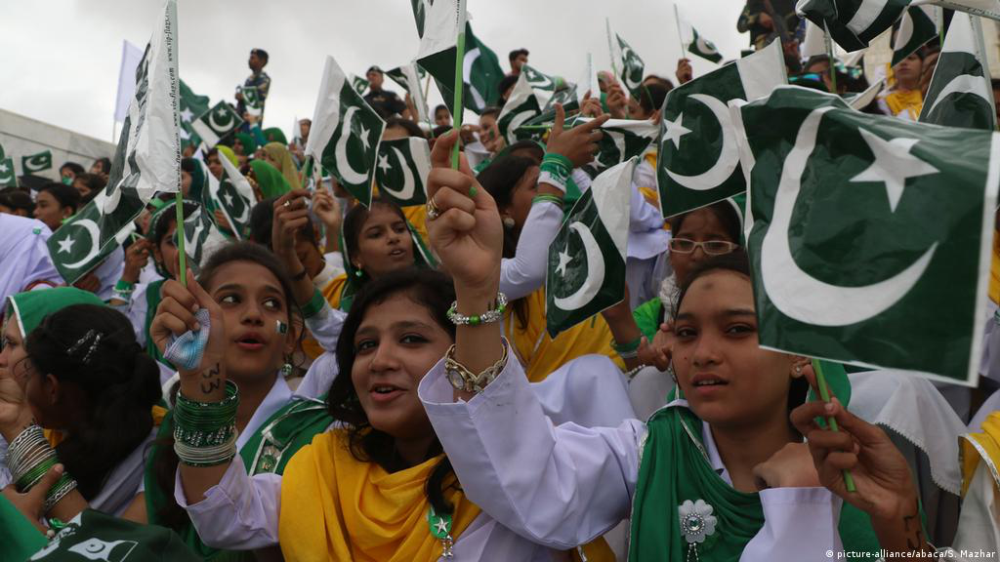

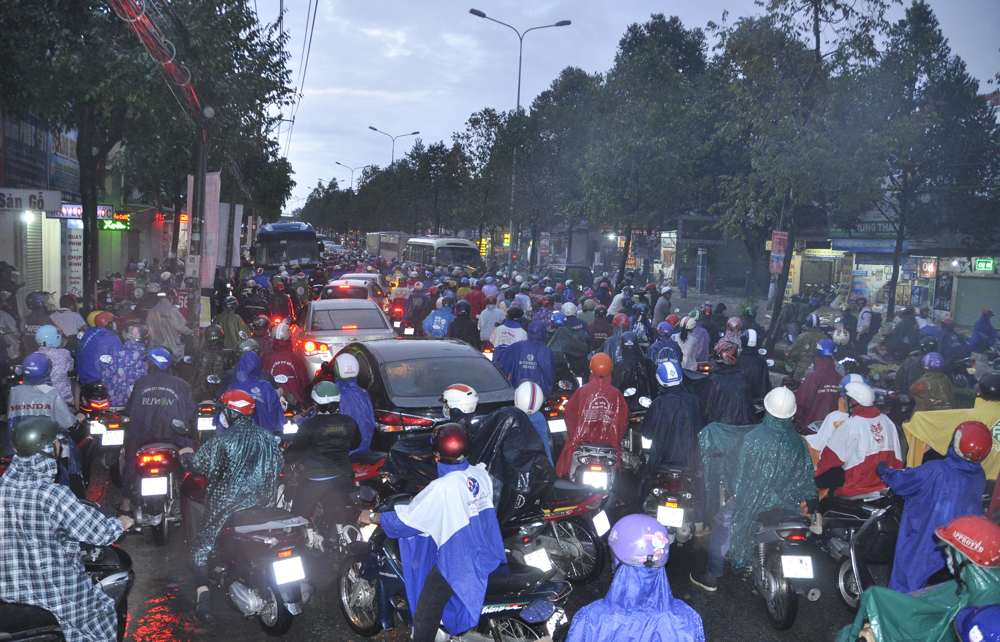

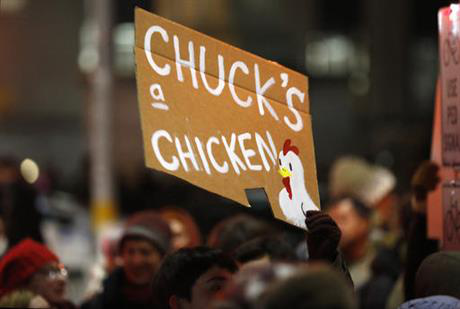

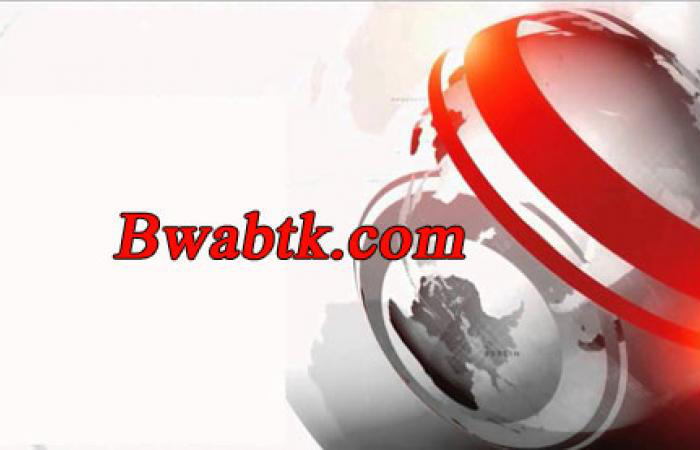

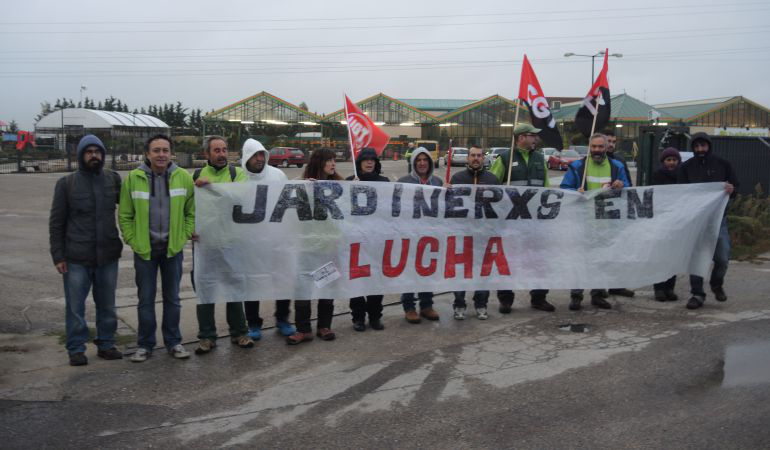

...

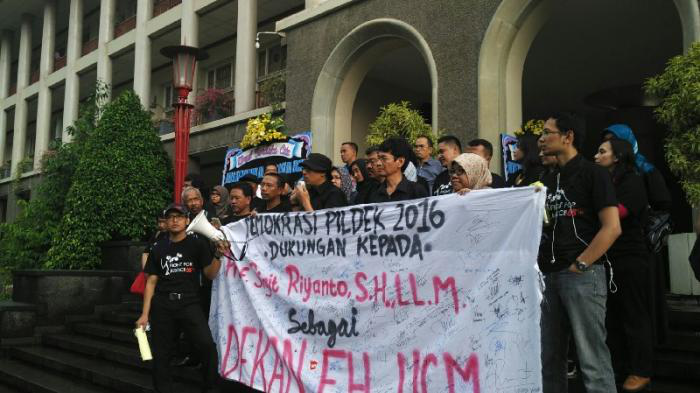

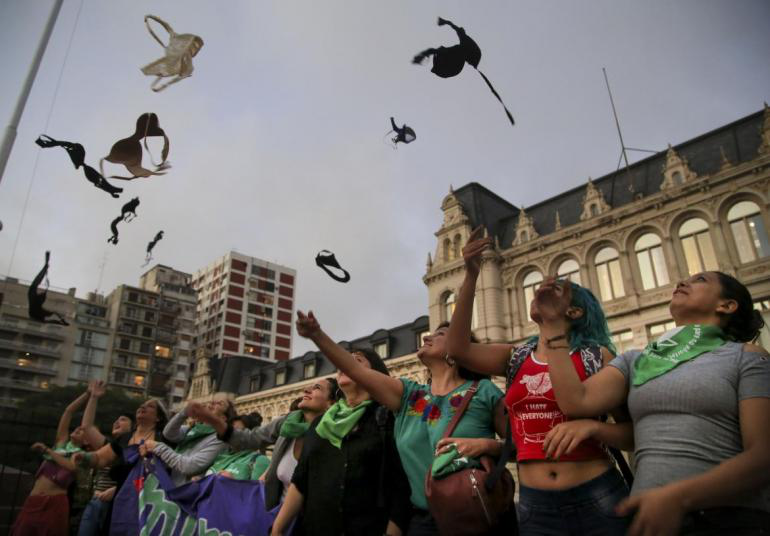

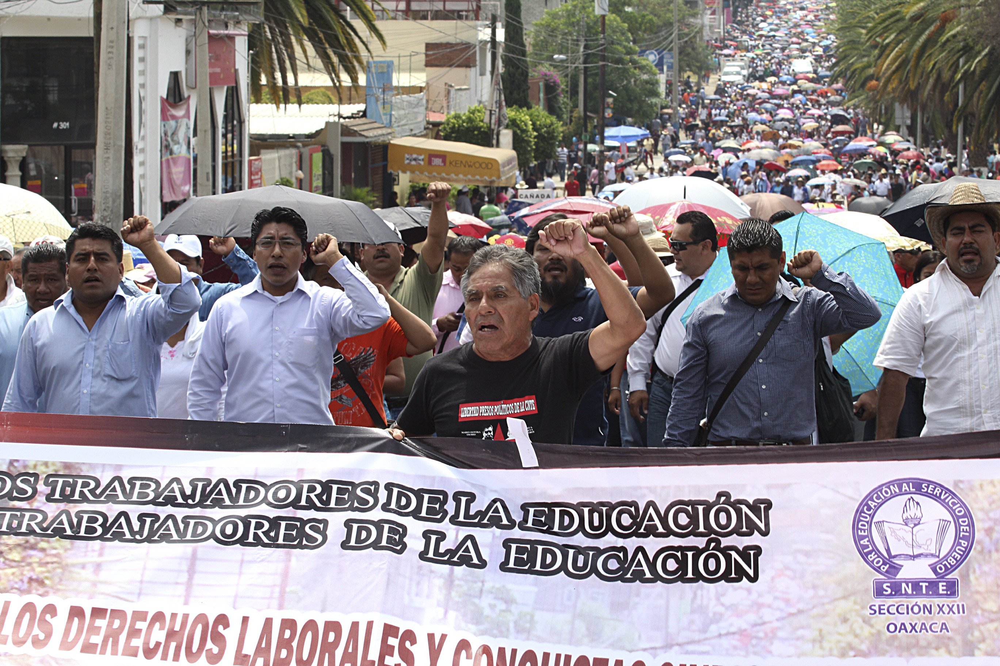

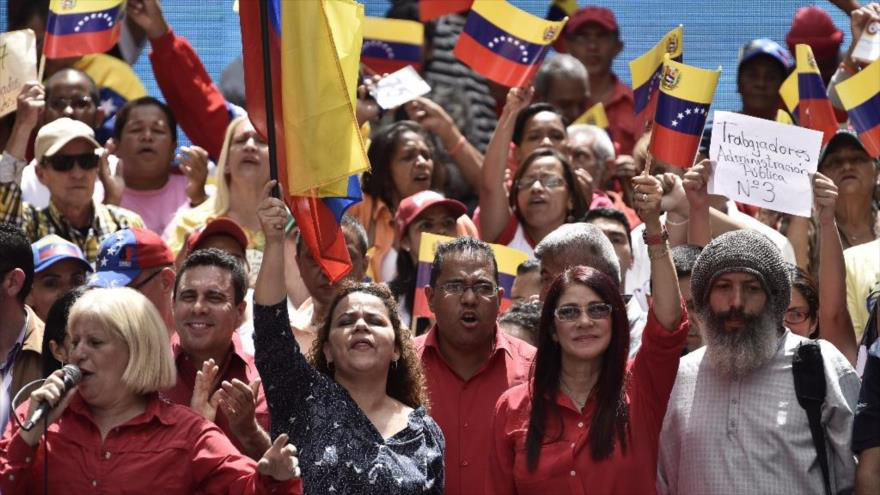

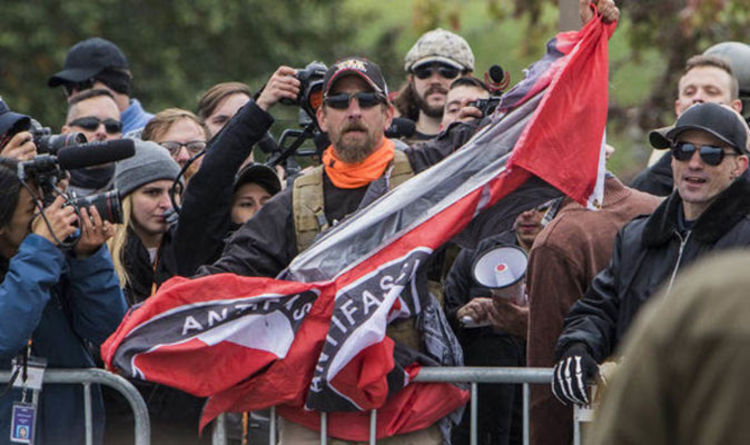

In [ ]:
for url in image_urls:
  image = io.imread(url)
  image_2 = cv.cvtColor(image, cv.COLOR_BGR2RGB)
  cv2_imshow(image_2)
  print('\n')

Image contours and histograms

In [ ]:
# Check the image matrix data type (could know the bit depth of the image)
print(image.dtype)
# Check the height of image
print(image.shape[0])
# Check the width of image
print(image.shape[1])
# Check the number of channels of the image
print(image.shape[2])

uint8
445
750
3


In [ ]:
import matplotlib.pylab as plt

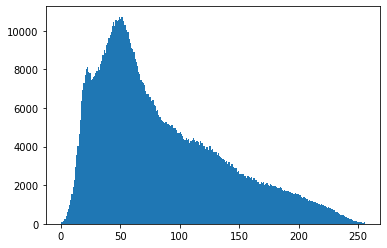

In [ ]:
plt.hist(image.ravel(),bins = 256, range = [0,256])
plt.show()

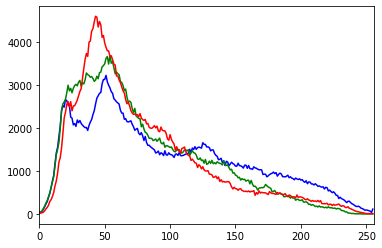

In [ ]:
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv.calcHist([image],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

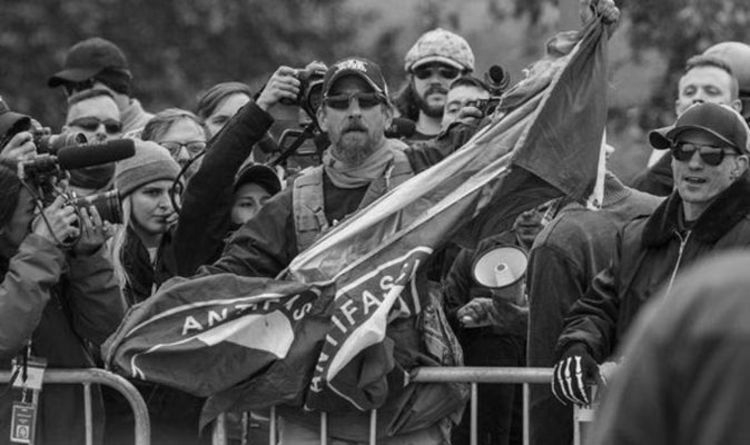

In [ ]:
myGrayImg = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
cv2_imshow(myGrayImg)

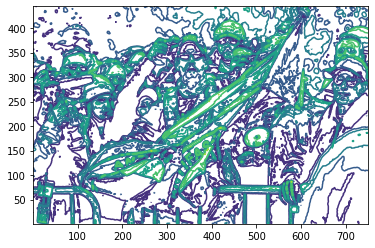

In [ ]:
plt.contour(myGrayImg, origin = "image")